In [45]:
# import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
import seaborn as sns
from mlxtend.frequent_patterns import apriori, association_rules
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, precision_score, recall_score, f1_score, roc_curve, auc

In [46]:
# load data
data = pd.read_csv('data/combineVle.csv')
data.shape

(25843, 19)

In [47]:
data.rename(columns={'total_score*weight':'total_score'}, inplace=True)
data.head()

,Unnamed: 0,id_student,code_module,code_presentation,total_score,attempted_weight,adjusted_mark,mark,gender,region,highest_education,imd_band,age_band,num_of_prev_attempts,studied_credits,disability,final_result,module_presentation,total_click
0,0,6516,AAA,2014J,6350.0,100.0,48.055203,31.8,M,Scotland,HE Qualification,80-90%,55<=,0,60,N,Pass,AAA_2014J,2791.0
1,1,8462,DDD,2013J,3490.0,40.0,NaN,NaN,M,London Region,HE Qualification,30-40%,55<=,0,90,N,Withdrawn,DDD_2013J,646.0
2,2,8462,DDD,2014J,4300.0,50.0,NaN,NaN,M,London Region,HE Qualification,30-40%,55<=,1,60,N,Withdrawn,DDD_2014J,10.0
3,3,11391,AAA,2013J,8240.0,100.0,64.006980,41.2,M,East Anglian Region,HE Qualification,90-100%,55<=,0,240,N,Pass,AAA_2013J,934.0
4,4,23629,BBB,2013B,1669.0,25.0,13.803681,8.3,F,East Anglian Region,Lower Than A Level,20-30%,0-35,2,60,N,Fail,BBB_2013B,161.0


In [4]:
data.shape

(25843, 19)

In [48]:
# when relevant columns have null value, drop null
columns_to_drop=["age_band", "highest_education", "imd_band", "module_presentation", "total_score", "total_click"]
data = data.dropna(subset=columns_to_drop, axis=0)
data.shape

(24845, 19)

In [49]:
# process data, change string to integer
# change age_band
data["age_band"] = data["age_band"].map({"0-35":1, "35-55":2, "55<=":3})

# preprocess "edu" column
data["highest_education"] = data["highest_education"] .map({"No Formal quals":0, "Lower Than A Level":1, "A Level or Equivalent":2, "HE Qualification":3, "Post Graduate Qualification":4})

# change imd_band 
data["imd_band"] = data["imd_band"].map({"0-10%":0, "10-20%":1, "20-30%":2, "30-40%":3, "40-50%":4, "50-60%":5, "60-70%":6, "70-80%":7, "80-90%":8, "90-100%":9})

# change module_presentation
change={"AAA_2013J":1, "AAA_2014J":2, "BBB_2013B":3, "BBB_2013J":4, "BBB_2014B":5, "BBB_2014J":6, "CCC_2014B":7, "CCC_2014J":8,\
        "DDD_2013B":9, "DDD_2013J":10, "DDD_2014B":11, "DDD_2014J":12, "EEE_2013J":13, "EEE_2014B":14, "EEE_2014J":15,\
        "FFF_2013B":16, "FFF_2013J":17, "FFF_2014B":18, "FFF_2014J":19, "GGG_2013J":20, "GGG_2014B":21, "GGG_2014J":22}
data["module_presentation"] = data["module_presentation"].map(change)

# change final_result, don't need to transfer
# data["final_result"] = data["final_result"].map({"Withdrawn":0,  "Fail":0,  "Pass":1, "Distinction":1})
data.shape

(24845, 19)

Factors are ['imd_band', 'age_band', 'highest_education', 'module_presentation', 'total_click']
Target will be 'total_score'. When total score is greater than 4000 which indicates that 'final_result' is pass, when greater than 8000 referring to distinction

In [50]:
extracted_data=data[['imd_band', 'age_band', 'highest_education', 'module_presentation', 'total_click','total_score']]
extracted_data.head()

,imd_band,age_band,highest_education,module_presentation,total_click,total_score
0,8,3,3,2,2791.0,6350.0
1,3,3,3,10,646.0,3490.0
2,3,3,3,12,10.0,4300.0
3,9,3,3,1,934.0,8240.0
4,2,1,1,3,161.0,1669.0


In [15]:
import plotly.express as px # Plotly provide better performance and interactivity for large datasets
# Prepare the data
x = extracted_data['total_score']  # 'total_score' column as x-axis
y = extracted_data.index  # Index as y-axis

# Create a scatter plot
fig = px.scatter(data_frame=data, x=x, y=y, color=x, color_continuous_scale=['yellow', 'blue'])

# Set color scale based on x-axis values
fig.update_traces(marker=dict(colorscale='Viridis', showscale=False))

# Add a vertical line at x = 4000
fig.add_shape(type="line", x0=4000, y0=0, x1=4000, y1=len(extracted_data), line=dict(color="red", width=1))

# Set plot title and labels
fig.update_layout(title='K-means Clustering', xaxis_title='Final Result', yaxis_title='Instance')

# Show the plot
fig.show()


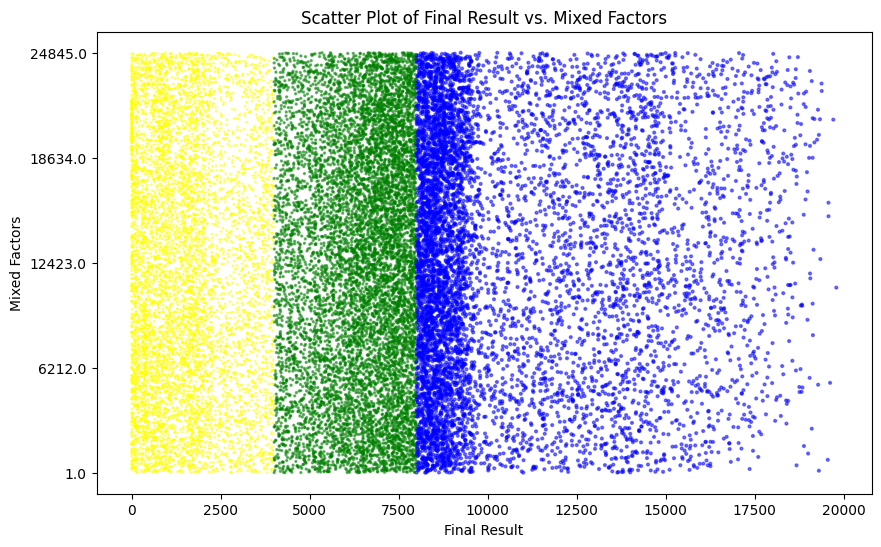

In [12]:
# improving scatter plot
x = np.array(extracted_data['total_score'])
y = np.arange(len(extracted_data))

colors = np.where(x < 4000, 'yellow', np.where(x < 8000, 'green', 'blue'))
# sizes = np.where(x < 4000, 10, 30)
sizes = np.where(x < 4000, 1, np.where(x < 8000, 2, 4))

plt.figure(figsize=(10, 6))
plt.scatter(x, y, c=colors, s=sizes, alpha=0.5)

# Adjust the y-axis ticks and labels
y_ticks = np.linspace(0, len(extracted_data) - 1, num=5)
plt.yticks(y_ticks, y_ticks + 1)

plt.xlabel('Final Result')
plt.ylabel('Mixed Factors')
plt.title('Scatter Plot of Final Result vs. Mixed Factors')

plt.show()

In [51]:
# K-Means clustering
km = KMeans(n_clusters=3,init = 'k-means++')
y_predicted = km.fit_predict(extracted_data)
y_predicted

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


array([0, 1, 1, ..., 0, 0, 0], dtype=int32)

In [52]:
data['cluster'] = y_predicted
data.head()

,Unnamed: 0,id_student,code_module,code_presentation,total_score,attempted_weight,adjusted_mark,mark,gender,region,highest_education,imd_band,age_band,num_of_prev_attempts,studied_credits,disability,final_result,module_presentation,total_click,cluster
0,0,6516,AAA,2014J,6350.0,100.0,48.055203,31.8,M,Scotland,3,8,3,0,60,N,Pass,2,2791.0,0
1,1,8462,DDD,2013J,3490.0,40.0,NaN,NaN,M,London Region,3,3,3,0,90,N,Withdrawn,10,646.0,1
2,2,8462,DDD,2014J,4300.0,50.0,NaN,NaN,M,London Region,3,3,3,1,60,N,Withdrawn,12,10.0,1
3,3,11391,AAA,2013J,8240.0,100.0,64.006980,41.2,M,East Anglian Region,3,9,3,0,240,N,Pass,1,934.0,0
4,4,23629,BBB,2013B,1669.0,25.0,13.803681,8.3,F,East Anglian Region,1,2,1,2,60,N,Fail,3,161.0,1


In [10]:
km.cluster_centers_

array([[3.88979159e+00, 1.27740492e+00, 1.64759213e+00, 1.08331567e+01,
        5.40550924e+02, 1.85300458e+03],
       [4.49396966e+00, 1.32785794e+00, 1.78490566e+00, 1.19565668e+01,
        2.02920333e+03, 7.41811571e+03],
       [4.95029961e+00, 1.31476912e+00, 2.01163201e+00, 9.90059922e+00,
        1.77588438e+03, 1.40963238e+04]])

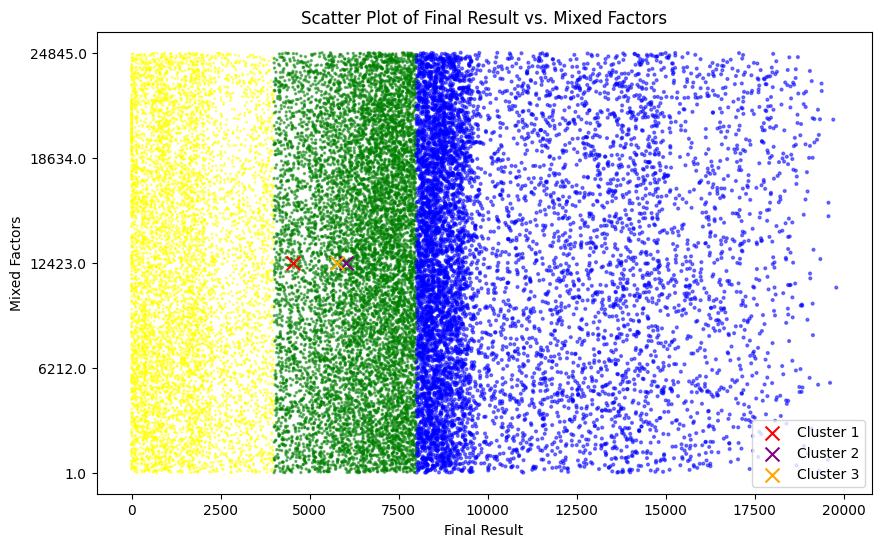

In [11]:
x = np.array(extracted_data['total_score'])
y = np.arange(len(extracted_data))

colors = np.where(x < 4000, 'yellow', np.where(x < 8000, 'green', 'blue'))
sizes = np.where(x < 4000, 1, np.where(x < 8000, 2, 4))

plt.figure(figsize=(10, 6))
plt.scatter(x, y, c=colors, s=sizes, alpha=0.5)

# Add the centers of K-means clustering
centers = km.cluster_centers_

center_colors = ['red', 'purple', 'orange']
center_labels = ['Cluster 1', 'Cluster 2', 'Cluster 3']

for center, color, label in zip(centers, center_colors, center_labels):
    plt.scatter(center[4] + 4000, y.mean(), c=color, s=100, alpha=1, marker='x', label=label)

# Adjust the y-axis ticks and labels
y_ticks = np.linspace(0, len(extracted_data) - 1, num=5)
plt.yticks(y_ticks, y_ticks + 1)

plt.xlabel('Final Result')
plt.ylabel('Mixed Factors')
plt.title('Scatter Plot of Final Result vs. Mixed Factors')
plt.legend()

plt.show()


In [53]:
df1 = data[data['cluster']==0]
df2 = data[data['cluster']==1]
df3 = data[data['cluster']==2]

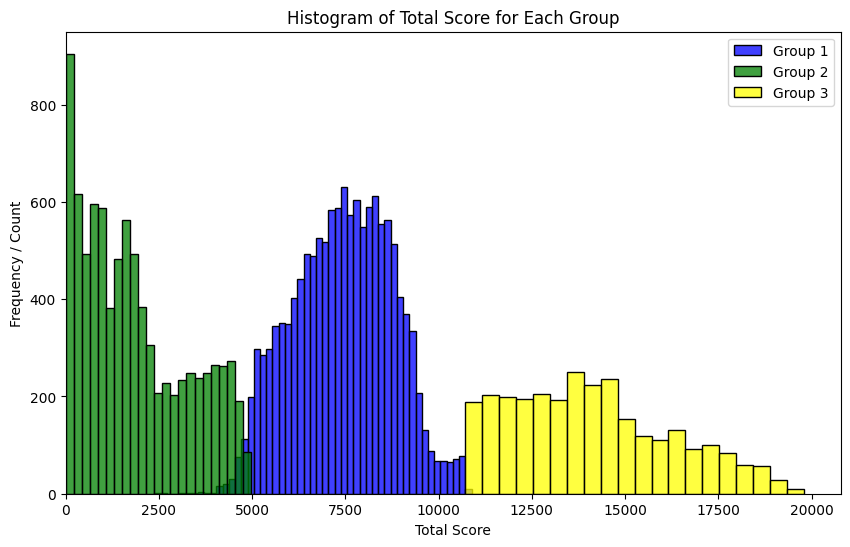

In [54]:
fig = plt.figure(figsize=(10,6))
sns.histplot(df1['total_score'], color='blue', label='Group 1')
sns.histplot(df2['total_score'], color='green', label='Group 2')
sns.histplot(df3['total_score'], color='yellow', label='Group 3')

plt.legend()
plt.xlabel('Total Score')
plt.ylabel('Frequency / Count')
plt.title('Histogram of Total Score for Each Group')

plt.xlim(left=0)  # Adjust the x-axis limit to include 0
plt.ylim(bottom=0)  # Adjust the y-axis limit to include 0

plt.show()
# plt.savefig('image/groupclustering.png')

In [55]:
data.groupby('id_student').sum()

,Unnamed: 0,code_module,code_presentation,total_score,attempted_weight,adjusted_mark,mark,gender,region,highest_education,imd_band,age_band,num_of_prev_attempts,studied_credits,disability,final_result,module_presentation,total_click,cluster
id_student,,,,,,,,,,,,,,,,,,,
6516,0,AAA,2014J,6350.0,100.0,48.055203,31.8,M,Scotland,3,8,3,0,60,N,Pass,2,2791.0,0
8462,3,DDDDDD,2013J2014J,7790.0,90.0,0.000000,0.0,MM,London RegionLondon Region,6,6,6,1,150,NN,WithdrawnWithdrawn,22,656.0,2
11391,3,AAA,2013J,8240.0,100.0,64.006980,41.2,M,East Anglian Region,3,9,3,0,240,N,Pass,1,934.0,0
23629,4,BBB,2013B,1669.0,25.0,13.803681,8.3,F,East Anglian Region,1,2,1,2,60,N,Fail,3,161.0,1
23698,5,CCC,2014J,10997.0,150.0,73.300000,55.0,F,East Anglian Region,2,5,1,0,120,N,Distinction,8,910.0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2698251,25837,DDD,2014B,10267.5,200.0,51.300000,51.3,F,South West Region,2,5,1,0,60,N,Distinction,11,1511.0,0
2698257,25838,AAA,2013J,6940.0,100.0,52.388959,34.7,M,East Midlands Region,1,6,1,0,120,N,Pass,1,758.0,0
2698535,51679,CCCEEE,2014B2013J,6281.0,139.0,43.023477,26.7,MM,WalesWales,2,10,2,0,120,NN,WithdrawnPass,20,4241.0,1


In [56]:
df1.groupby('id_student').sum()

,Unnamed: 0,code_module,code_presentation,total_score,attempted_weight,adjusted_mark,mark,gender,region,highest_education,imd_band,age_band,num_of_prev_attempts,studied_credits,disability,final_result,module_presentation,total_click,cluster
id_student,,,,,,,,,,,,,,,,,,,
6516,0,AAA,2014J,6350.0,100.0,48.055203,31.8,M,Scotland,3,8,3,0,60,N,Pass,2,2791.0,0
11391,3,AAA,2013J,8240.0,100.0,64.006980,41.2,M,East Anglian Region,3,9,3,0,240,N,Pass,1,934.0,0
23798,6,BBB,2013J,8924.0,100.0,90.340760,44.6,M,Wales,2,5,1,0,60,N,Distinction,4,590.0,0
24391,9,GGG,2013J,8000.0,100.0,77.863696,40.0,M,East Midlands Region,2,8,1,0,30,N,Distinction,20,712.0,0
25107,11,BBB,2013B,6051.0,100.0,46.151650,30.3,F,East Anglian Region,1,2,1,0,120,N,Pass,3,2562.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2698251,25837,DDD,2014B,10267.5,200.0,51.300000,51.3,F,South West Region,2,5,1,0,60,N,Distinction,11,1511.0,0
2698257,25838,AAA,2013J,6940.0,100.0,52.388959,34.7,M,East Midlands Region,1,6,1,0,120,N,Pass,1,758.0,0
2698535,25840,EEE,2013J,5344.0,100.0,43.023477,26.7,M,Wales,1,5,1,0,60,N,Pass,13,3455.0,0


In [57]:
df2.groupby('id_student').sum()

,Unnamed: 0,code_module,code_presentation,total_score,attempted_weight,adjusted_mark,mark,gender,region,highest_education,imd_band,age_band,num_of_prev_attempts,studied_credits,disability,final_result,module_presentation,total_click,cluster
id_student,,,,,,,,,,,,,,,,,,,
8462,3,DDDDDD,2013J2014J,7790.0,90.0,0.000000,0.0,MM,London RegionLondon Region,6,6,6,1,150,NN,WithdrawnWithdrawn,22,656.0,2
23629,4,BBB,2013B,1669.0,25.0,13.803681,8.3,F,East Anglian Region,1,2,1,2,60,N,Fail,3,161.0,1
24186,7,GGG,2014B,4000.0,66.7,40.301396,20.0,F,Yorkshire Region,1,1,1,0,30,Y,Pass,21,184.0,1
24734,10,AAA,2014J,4750.0,100.0,41.446701,23.8,F,South Region,1,6,1,0,60,N,Pass,2,499.0,1
25261,13,CCC,2014J,156.0,2.0,0.000000,0.0,F,Scotland,3,4,1,0,60,N,Withdrawn,8,997.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2694139,25821,FFF,2014J,2400.0,50.0,0.000000,0.0,M,East Anglian Region,1,7,2,0,60,N,Withdrawn,19,1382.0,1
2694680,25823,FFF,2013J,4325.0,50.0,27.852761,21.6,M,East Midlands Region,1,8,1,1,90,N,Fail,17,48.0,1
2694788,25824,AAA,2014J,1610.0,50.0,13.044479,8.0,F,South Region,2,7,2,0,180,Y,Fail,2,100.0,1


In [58]:
df3.groupby('id_student').sum()

,Unnamed: 0,code_module,code_presentation,total_score,attempted_weight,adjusted_mark,mark,gender,region,highest_education,imd_band,age_band,num_of_prev_attempts,studied_credits,disability,final_result,module_presentation,total_click,cluster
id_student,,,,,,,,,,,,,,,,,,,
23698,5,CCC,2014J,10997.0,150.0,73.3,55.0,F,East Anglian Region,2,5,1,0,120,N,Distinction,8,910.0,2
24213,8,DDD,2014B,13640.0,200.0,68.2,68.2,F,East Anglian Region,2,4,1,1,60,N,Distinction,11,1992.0,2
27116,22,CCC,2014J,14002.0,150.0,93.3,70.0,M,Yorkshire Region,3,7,1,0,120,N,Distinction,8,1847.0,2
29411,43,DDD,2013J,13765.0,200.0,68.8,68.8,M,East Midlands Region,2,8,1,0,60,N,Distinction,10,841.0,2
29764,47,CCC,2014B,13665.0,150.0,91.1,68.3,M,East Anglian Region,2,5,1,0,90,N,Distinction,7,2867.0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2692186,25811,DDD,2013J,11535.0,180.0,64.1,57.7,F,North Western Region,1,2,1,1,60,Y,Distinction,10,708.0,2
2692577,25815,DDD,2014B,15617.5,200.0,78.1,78.1,M,South Region,1,8,1,0,70,N,Distinction,11,985.0,2
2693243,25819,DDD,2013B,17058.0,200.0,85.3,85.3,F,Yorkshire Region,1,5,2,0,60,N,Distinction,9,2643.0,2


In [59]:
pd.DataFrame(data).to_csv("data/groupeddata.csv")